In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import descartes
from tqdm import tqdm
import geopandas as gpd
import pickle
from shapely.geometry import Point, Polygon

%matplotlib inline

# Get file names in dir os_road_maps and load into a list
import os

def list_files(directory):
    try:
        # Get the list of all files and directories
        files = os.listdir(directory)
        
        # Filter the list to include only files (excluding directories)
        file_list = [f for f in files if os.path.isfile(os.path.join(directory, f))]
        
        return file_list
    except FileNotFoundError:
        return "The specified directory does not exist."
    except PermissionError:
        return "You do not have permission to access this directory."

# Example usage:
directory_path = 'data/os_road_maps'
files = list_files(directory_path)

shx_files = []
for f in files:
    if f[-1] == 'x':
        if 'Node' not in f:
            shx_files.append(f)

print(shx_files)

london = gpd.read_file('data/London_Ward.shx')

for f in shx_files:

    map = 'data/os_road_maps/' + f

    street_map = gpd.read_file(map)

    fig, ax = plt.subplots(figsize=(15,15))
    london.plot(ax=ax)
    street_map.plot(ax=ax, color='red')
    fig.suptitle(f)

# ax.set_xlim(520000, 540000)
# ax.set_ylim(175000, 185000)
# London is TQ.


<Axes: >

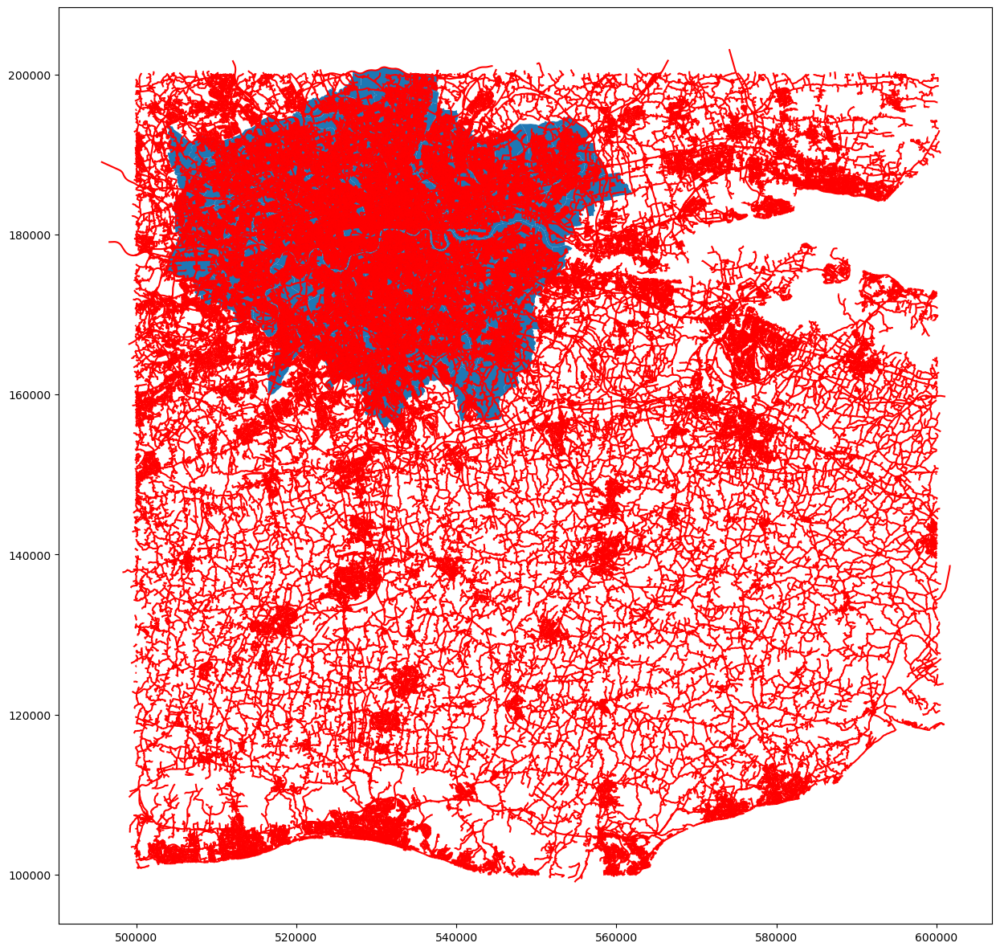

In [38]:

map = 'data/os_road_maps/TQ_RoadLink.shx'

street_map = gpd.read_file(map)

fig, ax = plt.subplots(figsize=(15,15))
london.plot(ax=ax)
street_map.plot(ax=ax, color='red')

In [43]:
street_map['geometry'][0:5]

0    LINESTRING Z (540213.670 199996.480 0.000, 540...
1    LINESTRING Z (536749.210 200040.950 0.000, 536...
2    LINESTRING Z (539817.070 200024.820 0.000, 539...
3    LINESTRING Z (539313.000 199992.000 0.000, 539...
4    LINESTRING Z (538304.780 200055.800 0.000, 538...
Name: geometry, dtype: geometry

In [121]:

area_of_interest = Polygon([(522500, 190000), (540000, 190000), (540000, 175000), (522500, 175000)])
area_of_interest = gpd.GeoSeries([area_of_interest], crs=street_map.crs)
gdf = street_map['geometry'][street_map['geometry'].geometry.intersects(area_of_interest.iloc[0])]

In [137]:
# Merge back together
df = pd.DataFrame(gdf)
street_map_filtered = df.merge(street_map, on='geometry')

road_mapping = {
    'Motorway': 1.0,
    'A Road': 0.8,
    'B Road': 0.5,
    'Local Road': 0.3,
    'Minor Road': 0.2,
    'Secondary Access Road': 0.05,
    'Local Access Road': 0.05,
    'Restricted Local Access Road': 0.05
}

# road_color_mapping = {
#     'Motorway': 'black',
#     'A Road': 'purple',
#     'B Road': 'blue',
#     'Local Road': 'orange',
#     'Minor Road': 'green',
#     'Secondary Access Road': 'yellow',
#     'Local Access Road': 'yellow',
#     'Restricted Local Access Road': 'yellow'
# }

road_color_mapping = {
    'Motorway': 'black',
    'A Road': 'dimgray',
    'B Road': 'gray',
    'Local Road': 'darkgray',
    'Minor Road': 'silver',
    'Secondary Access Road': 'silver',
    'Local Access Road': 'silver',
    'Restricted Local Access Road': 'silver'
}

street_map_filtered['function_mapped'] = street_map_filtered['function'].map(road_mapping)
street_map_filtered['function_color_mapped'] = street_map_filtered['function'].map(road_color_mapping)

street_map_filtered.to_pickle('pickle/street_map_filtered')

In [134]:
street_map_filtered.tail()

,geometry,fictitious,identifier,class,roadNumber,name1,name1_lang,name2,name2_lang,formOfWay,...,trunkRoad,loop,startNode,endNode,structure,nameTOID,numberTOID,function,function_mapped,function_color_mapped
52676,"LINESTRING Z (522520.000 185350.000 0.000, 522...",false,0962D0AC-1EA9-42F7-8589-3CFB416D437E,Unclassified,None,Cullingworth Road,None,None,None,Single Carriageway,...,false,false,FD4CE580-2779-470A-BACC-A934EF3842EF,1D3DB355-534F-4282-8F70-3562C24A2FAD,None,osgb4000000030499677,None,Local Road,0.3,darkgray
52677,"LINESTRING Z (522520.000 185350.000 0.000, 522...",false,6D4A3031-12E2-4B0B-9698-A6455F41C4BB,Unclassified,None,Fleetwood Road,None,None,None,Single Carriageway,...,false,false,FD4CE580-2779-470A-BACC-A934EF3842EF,4AB4F2A7-6D71-4A75-88DE-BC0CDD06CBE0,None,osgb4000000030487658,None,Local Road,0.3,darkgray
52678,"LINESTRING Z (522534.000 185415.000 0.000, 522...",false,5A927DAE-7921-49C5-B8F5-1F60B5D9D80A,Unclassified,None,Cullingworth Road,None,None,None,Single Carriageway,...,false,false,9052DB1E-71A5-4C48-B4B5-58DAEC0CB0D1,FD4CE580-2779-470A-BACC-A934EF3842EF,None,osgb4000000030499677,None,Local Road,0.3,darkgray
52679,"LINESTRING Z (522285.000 185471.000 0.000, 522...",false,8D7807E7-1A5C-4C05-B937-B7E72C6D19C7,Unclassified,None,Geary Road,None,None,None,Single Carriageway,...,false,false,C9CD548F-8316-4D2F-9E65-042A79C9F604,9052DB1E-71A5-4C48-B4B5-58DAEC0CB0D1,None,osgb4000000030487661,None,Local Road,0.3,darkgray
52680,"LINESTRING Z (522298.000 185527.000 0.000, 522...",false,5E25F3BB-7C54-4935-A5FA-D11E7A72DA94,Unclassified,None,Kendal Road,None,None,None,Single Carriageway,...,false,false,2038A841-1800-4B93-9210-01320F091122,5588635A-CC39-4A34-B008-6BA82970DDD1,None,osgb4000000030487660,None,Minor Road,0.2,silver


for idx, geom in street_map['geometry'][:448000].items():
    # print(geom)
    if geom.intersects(area_of_interest.iloc[0]):
        print(f"Geometry {idx} intersects with the area of interest")
    else:
        # print(f"Geometry {idx} does not intersect with the area of interest")
        pass

  0%|          | 0/52681 [00:00<?, ?it/s]

100%|██████████| 52681/52681 [00:28<00:00, 1848.51it/s]


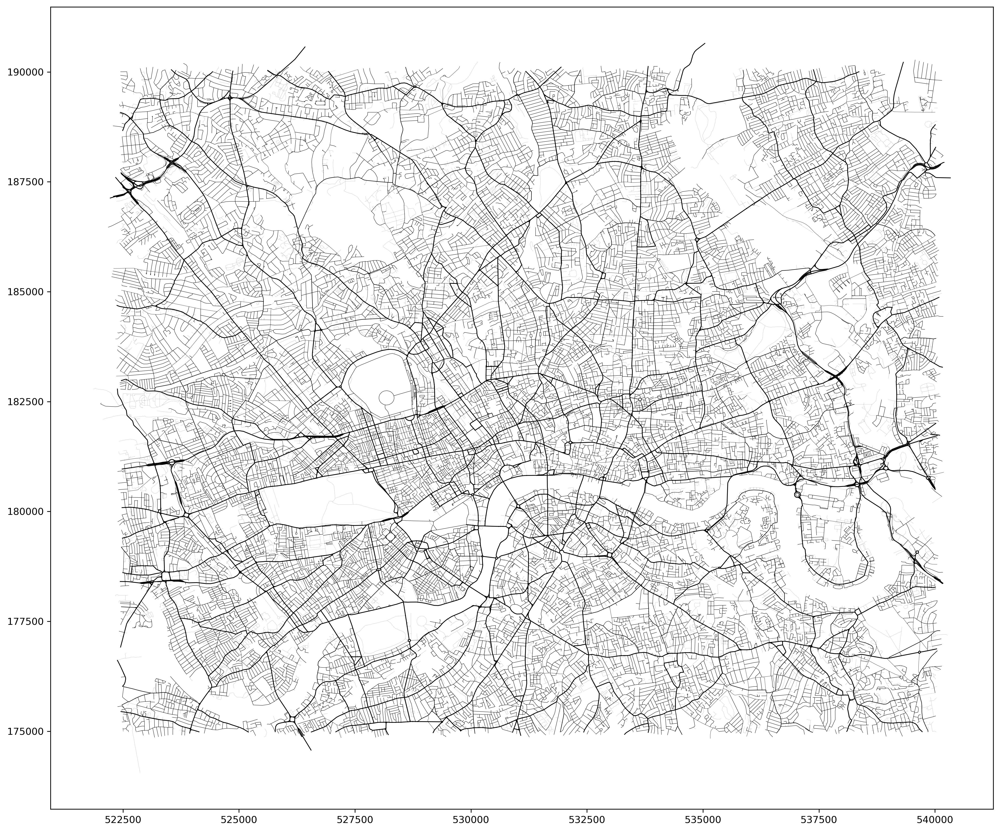

In [170]:
fig, ax = plt.subplots(figsize=(17.5,15), dpi=300)

for idx, row in tqdm(street_map_filtered.iterrows(), total=len(street_map_filtered)):
    # print(row)
    # print(row['geometry'])
    # gdf.plot(ax=ax, color='blue', label='LineStrings')
    a = row['geometry'].xy
    x, y = a
    # print(x)
    ax.plot(x, y, color='black', lw=row['function_mapped'])
    # ax.plot(x, y, color=row['function_color_mapped'])

with open('pickle/London_road_fig.pkl', 'wb') as f:
    pickle.dump(fig, f)
    
plt.show()




/tmp/ipykernel_70674/2822907074.py:4: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  loaded_fig.show()


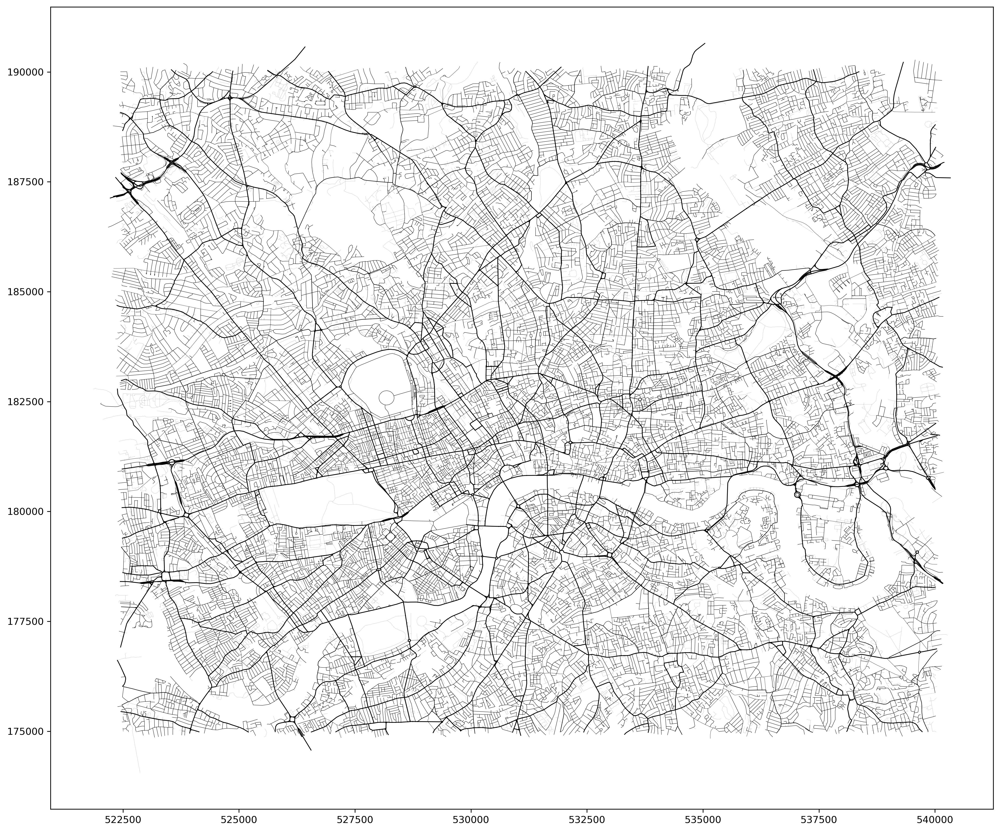

Loaded Pickle


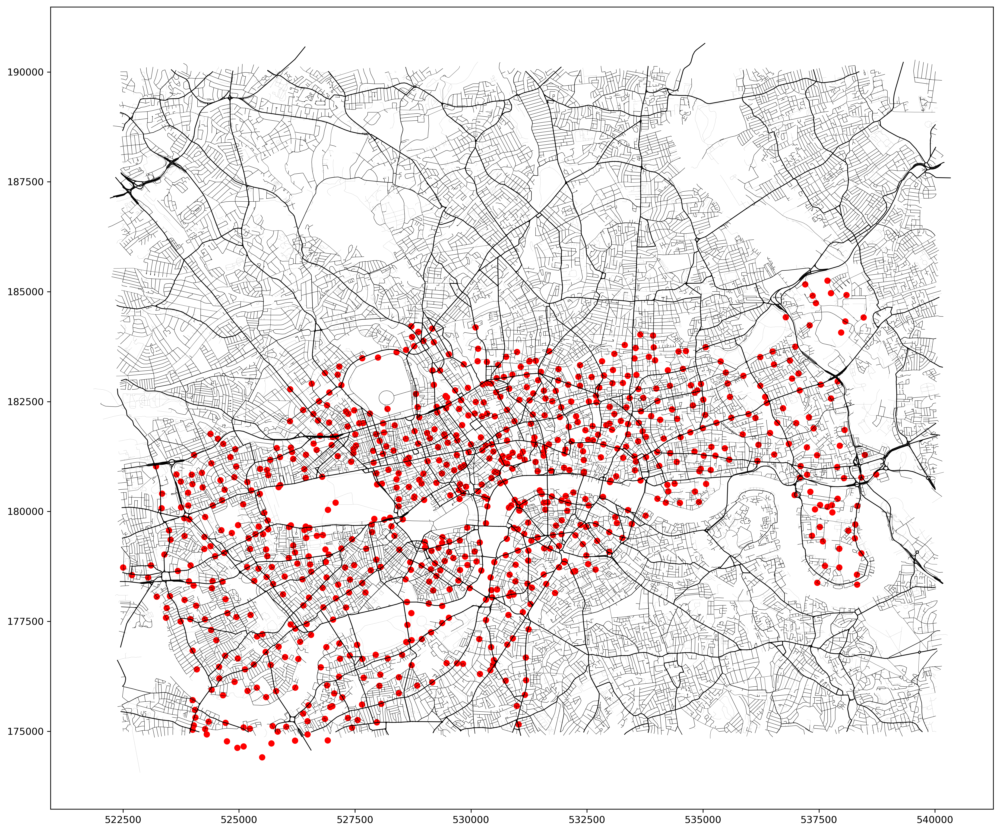

In [2]:
try:
    with open('pickle/London_road_fig.pkl', 'rb') as f:
        loaded_fig = pickle.load(f)
        ax = loaded_fig.axes[0]
        print("Loaded Pickle")
    # loaded_fig.show()
except EOFError:
    print("Error: The file is empty or corrupted.")
except Exception as e:
    print(f"An error occurred: {e}")

docks = pd.read_csv('data/docking_station_locations.txt')
docks = docks[~(docks['StationName']=='Pop Up Dock 1')]
        docks['geometry'] = [Point(xy) for xy in zip(docks['Easting'], docks['Northing'])]
docks.head()

for idx, row in docks.iterrows():
    
    ax.scatter(row['Easting'], row['Northing'], color='red', lw=0.5)

# docks['geometry'].plot(ax=ax)
# plt.show()

In [10]:
t = docks.sort_values(['Easting', 'Northing'])
t = t[~(t['StationName']=='Pop Up Dock 1')]
print(t)

     Station.Id                            StationName  longitude  latitude  \
636         668  Ravenscourt Park Station, Hammersmith  -0.236770   51.4942   
721         753     Hammersmith Town Hall, Hammersmith  -0.234094   51.4926   
698         730             Bridge Avenue, Hammersmith  -0.229117   51.4921   
566         598           Southerton Road, Hammersmith  -0.228188   51.4945   
569         601             BBC White City, White City  -0.225787   51.5148   
..          ...                                    ...        ...       ...   
511         538                   Naval Row, Blackwall  -0.006990   51.5090   
421         447          Jubilee Crescent, Cubitt Town  -0.007542   51.4934   
758         790           Stratford Station, Stratford  -0.004810   51.5418   
527         554               Aberfeldy Street, Poplar  -0.005659   51.5135   
520         547              East India DLR, Blackwall  -0.002275   51.5095   

        Easting    Northing                        

In [14]:
start_geometry = [Point(xy) for xy in zip(df['start_longitude'], df['start_latitude'])]

In [15]:
geo_df = gpd.GeoDataFrame(df, #specify our data
                          crs=crs, #specify our coordinate reference system
                          geometry=start_geometry) #specify the geometry list we created
geo_df.head()

/home/oren/miniconda3/envs/ML/lib/python3.10/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


CRSError: Invalid projection: +init=ESRI:102400 +type=crs: (Internal Proj Error: proj_create: cannot expand +init=ESRI:102400 +type=crs)